# Neural Style transfer 실습 

## Style transfer task

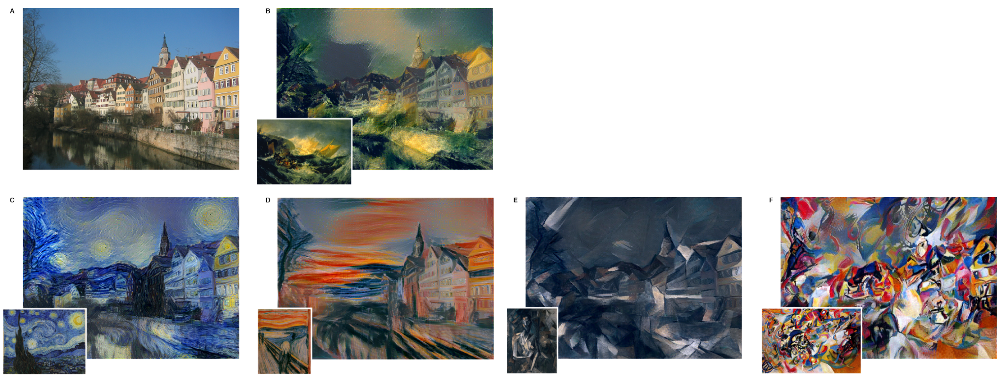

## Model overview

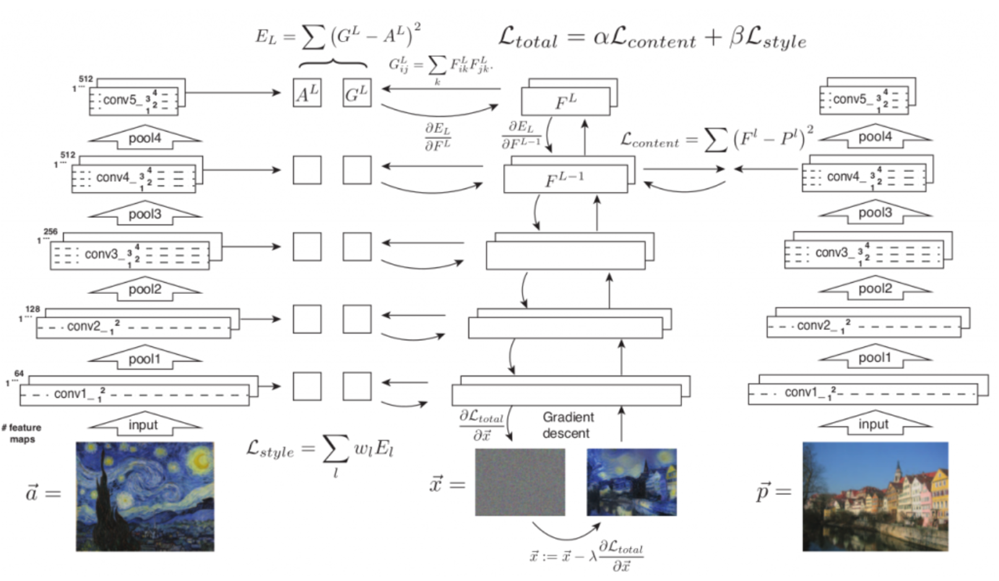

## Library

In [1]:
import os
os.environ['CUDA_VISIBLE_DEVICES'] = '0'
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
from tqdm.notebook import tqdm

In [2]:
import torch
import torch.nn as nn
import torchvision
from torchvision import models
from torchvision import transforms

## Hyperparameters

In [3]:
"""
학습에 사용될 hyperparameter 값들을 넣을 class를 정의합니다.
"""
class AttrDict(dict):
    def __init__(self, *args, **kwargs):
        super(AttrDict, self).__init__(*args, **kwargs)
        self.__dict__ = self

In [4]:
"""
Style transfer model에서 사용할 content image와 style image를 지정합니다.
그 외에 결과 이미지 저장 경로, 에포크 수, 모델 입력 이미지 크기 등을 정의합니다.
"""
config = AttrDict()
config.content_img = 'data2/mountain.jpg'
config.style_img = 'data2/muk.jpg'
config.save_path = 'save/'
config.n_epoch = 3000
config.log_interval = 100
config.save_interval = 100
config.style_loss_weight = 1
config.learning_rate = 0.01
config.img_size = 512
"""
모델 입력 이미지에 수행할 normalization과 모델 생성 결과 이미지에 수행할 denormalization을 정의합니다.
"""
config.augmentation = transforms.Compose([
                        transforms.Resize(config.img_size),
                        transforms.ToTensor(),
                        transforms.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)) 
                      ])
config.denormalize = lambda x:x*torch.tensor([[[0.229]], [[0.224]], [[0.225]]])+torch.tensor([[[0.485]], [[0.456]], [[0.406]]])
config.device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

In [5]:
if not os.path.isdir(config.save_path):
    os.makedirs(config.save_path)

In [6]:
config.device

device(type='cuda')

## Data load

In [7]:
"""
이미지를 불러와 torch tensor로 바꾸는 이미지 전처리 함수를 정의합니다.
"""
def image_preprocess(image_path, transform=None, visualize_flag = False):
    image = Image.open(image_path)
    
    if visualize_flag:
        plt.title('Raw input image of {}'.format(image_path))
        plt.imshow(image)
        plt.show()
        
    if transform:
        image = transform(image)
        
        if visualize_flag:
            plt.title("transformed input image of {}".format(image_path))
            plt.imshow(config.denormalize(image).permute(1,2,0))
            plt.show()
            
    return image.unsqueeze(0).to(config.device)

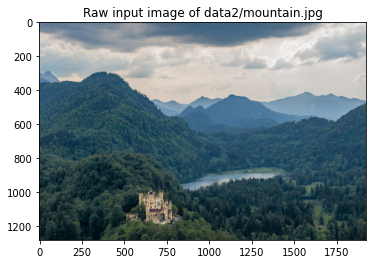

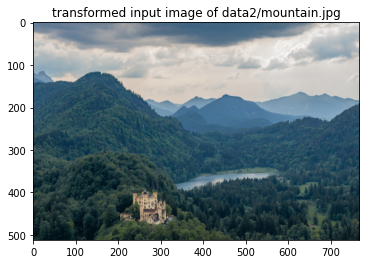

tensor([[[[-0.2684, -0.2856, -0.3027,  ...,  1.7865,  1.7694,  1.7694],
          [-0.2684, -0.2856, -0.3027,  ...,  1.7523,  1.7352,  1.7009],
          [-0.2684, -0.2856, -0.3027,  ...,  1.7180,  1.6838,  1.6495],
          ...,
          [-1.9295, -1.8782, -1.8097,  ..., -1.9295, -1.8439, -1.9980],
          [-1.7240, -1.6555, -1.6213,  ..., -2.0323, -1.9638, -2.0494],
          [-1.7069, -1.7240, -1.6898,  ..., -2.0665, -2.0494, -2.1008]],

         [[ 0.2052,  0.1877,  0.1702,  ...,  1.9559,  1.9384,  1.9384],
          [ 0.2052,  0.1877,  0.1702,  ...,  1.9209,  1.9034,  1.8683],
          [ 0.2052,  0.1877,  0.1702,  ...,  1.8859,  1.8508,  1.8158],
          ...,
          [-1.3880, -1.3354, -1.2829,  ..., -1.5980, -1.5105, -1.6856],
          [-1.1779, -1.1078, -1.1078,  ..., -1.7031, -1.6331, -1.7381],
          [-1.1604, -1.1779, -1.1779,  ..., -1.7731, -1.7381, -1.7906]],

         [[ 0.8448,  0.8448,  0.8274,  ...,  2.1694,  2.1520,  2.1520],
          [ 0.8448,  0.8448,  

In [8]:
image_preprocess(config.content_img, config.augmentation, True)

In [9]:
"""
content image와 style image의 전처리를 수행합니다.
"""
content_img = image_preprocess(config.content_img, config.augmentation)
style_img = image_preprocess(config.style_img, config.augmentation)

"""
최종으로 생성될 이미지는 content image로 초기값을 설정합니다.
이 이미지는 학습 과정을 통해 주어진 content와 style을 반영한 이미지로 업데이트됩니다.
따라서 requires grad는 True로 설정합니다.
"""
target_img = content_img.clone().requires_grad_(True)

## Backbone network

- [torchvision.models](https://pytorch.org/vision/stable/models.html) provides image classification models pretrained on ImageNet. 
- The models can be used to extract features from given image.

In [10]:
"""
ImageNet에 pretrained된 VGG19 모델을 사용하여 이미지들의 feature 정보를 얻습니다.
이 모델의 weights는 업데이트되지 않고, 사전 학습된 그대로 사용돕니다.  
"""
models.vgg19(pretrained=True)

VGG(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace=True)
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (6): ReLU(inplace=True)
    (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): ReLU(inplace=True)
    (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace=True)
    (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): ReLU(inplace=True)
    (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (15): ReLU(inplace=True)
    (16): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padd

In [11]:
"""
선택된 layer의 image feature들이 학습에 사용되게 됩니다.
"""
model = models.vgg19(pretrained=True).features
for n, layer in model._modules.items():
    print('number: {} layer: {}'.format(n, layer))

number: 0 layer: Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
number: 1 layer: ReLU(inplace=True)
number: 2 layer: Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
number: 3 layer: ReLU(inplace=True)
number: 4 layer: MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
number: 5 layer: Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
number: 6 layer: ReLU(inplace=True)
number: 7 layer: Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
number: 8 layer: ReLU(inplace=True)
number: 9 layer: MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
number: 10 layer: Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
number: 11 layer: ReLU(inplace=True)
number: 12 layer: Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
number: 13 layer: ReLU(inplace=True)
number: 14 layer: Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
number

In [12]:
"""
주어진 이미지를 VGG19에 통과시켜 5개의 layer에서 image feature를 뽑아 리턴하는 모델을 정의합니다.
content image, style image, target image를 한 번에 받아 세 개의 이미지에 대하여 각각 5개의 feature들을 출력합니다.
"""
class feature_model(nn.Module):
    def __init__(self):
        super(feature_model, self).__init__()
        self.model = models.vgg19(pretrained=True).features
        self.selected_layer = ['0', '5', '10', '19', '28']
        
    def forward(self, x_list):
        feature_list = []
        for x in x_list:
            feature_list.append(self._forward(x))
        return feature_list
    
    def _forward(self, x):
        selected_features = []
        for n, layer in self.model._modules.items():
            x = layer(x)
            if n in self.selected_layer:
                selected_features.append(x)
        return selected_features

In [13]:
"""
업데이트되는 것은 모델이 아닌 이미지이기 때문에, optimizer에 이미지 변수를 넣어줍니다.
"""
optimizer = torch.optim.Adam([target_img], lr=config.learning_rate)
criterion = nn.MSELoss()
model = feature_model().to(config.device)
model.eval()

feature_model(
  (model): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace=True)
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (6): ReLU(inplace=True)
    (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): ReLU(inplace=True)
    (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace=True)
    (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): ReLU(inplace=True)
    (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (15): ReLU(inplace=True)
    (16): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1

## Training

In [14]:
"""
target image를 업데이트합니다.
"""
for i in tqdm(range(config.n_epoch)):
    c, s, t = model([content_img, style_img, target_img])

    style_loss = 0
    content_loss = 0
    for content_feature, style_feature, target_feature in zip(c, s, t):
        """
        target image가 초기값으로 사용된 content image와 같은 content를 유지하도록 하는 loss입니다.
        """
        content_loss += criterion(target_feature, content_feature)

        """
        target image와 style image의 gram matrix를 계산합니다. 
        """
        style_feature = style_feature.reshape(style_feature.shape[1], -1)
        target_feature = target_feature.reshape(target_feature.shape[1], -1)
        style_feature = torch.mm(style_feature, style_feature.t())
        target_feature = torch.mm(target_feature, target_feature.t())

        """
        target image와 style image의 gram matrix가 서로 같아지도록 하는 loss입니다.
        """
        style_loss += criterion(target_feature, style_feature) / (style_feature.shape[0] * style_feature.shape[1]) 

    """
    content loss와 style loss를 합친 최종 loss를 이용하여 target image를 업데이트합니다.
    style loss weight를 조절하여 style을 얼마나 주입시킬지를 바꿀 수 있습니다.
    """
    loss = content_loss + style_loss * config.style_loss_weight
    optimizer.zero_grad()
    loss.backward()
    optimizer.step()

    if (i+1) % config.log_interval == 0:
        print('Epoch [{}/{}] Content loss: {:.4f} Style loss: {:.4f}' 
                   .format(i+1, config.n_epoch, content_loss.item(), style_loss.item()))

    if (i+1) % config.save_interval == 0:
        save_path = os.path.join(config.save_path, 
                                 'content_[{}]_style_[{}]_weight_[{}]_epoch_[{}].png'.format(config.content_img.split('/')[-1], 
                                                                                             config.style_img.split('/')[-1], 
                                                                                             config.style_loss_weight, i+1))
        save_img = target_img.squeeze(0).data.cpu()
        save_img = config.denormalize(save_img).clamp(0., 1.)
        torchvision.utils.save_image(save_img, save_path)

  0%|          | 0/3000 [00:00<?, ?it/s]

Epoch [100/3000] Content loss: 10.3764 Style loss: 50669.6016
Epoch [200/3000] Content loss: 11.8761 Style loss: 20188.9004
Epoch [300/3000] Content loss: 12.5369 Style loss: 10472.6484
Epoch [400/3000] Content loss: 12.8891 Style loss: 6360.9731
Epoch [500/3000] Content loss: 13.1118 Style loss: 4282.1729
Epoch [600/3000] Content loss: 13.2776 Style loss: 3064.6667
Epoch [700/3000] Content loss: 13.3923 Style loss: 2274.9265
Epoch [800/3000] Content loss: 13.4860 Style loss: 1725.8694
Epoch [900/3000] Content loss: 13.5591 Style loss: 1327.6315
Epoch [1000/3000] Content loss: 13.6146 Style loss: 1031.4198
Epoch [1100/3000] Content loss: 13.6555 Style loss: 807.9197
Epoch [1200/3000] Content loss: 13.6829 Style loss: 637.7622
Epoch [1300/3000] Content loss: 13.7028 Style loss: 507.5229
Epoch [1400/3000] Content loss: 13.7161 Style loss: 407.4465
Epoch [1500/3000] Content loss: 13.7219 Style loss: 330.3359
Epoch [1600/3000] Content loss: 13.7215 Style loss: 270.7732
Epoch [1700/3000] Co

## Qualitative results

In [15]:
'''
시각화 코드 단순화를 위한 함수를 정의해 줍니다.
'''
def draw_images(content_img, style_img, target_img, target_img_name):
    plt.figure(figsize = (20,60))
    plt.subplot(1,3,1)
    plt.title('content image')
    plt.imshow(content_img)
    
    plt.subplot(1,3,2)
    plt.title('style image')
    plt.imshow(style_img)
    
    plt.subplot(1,3,3)
    plt.title(target_img_name)
    plt.imshow(target_img)
    plt.show()

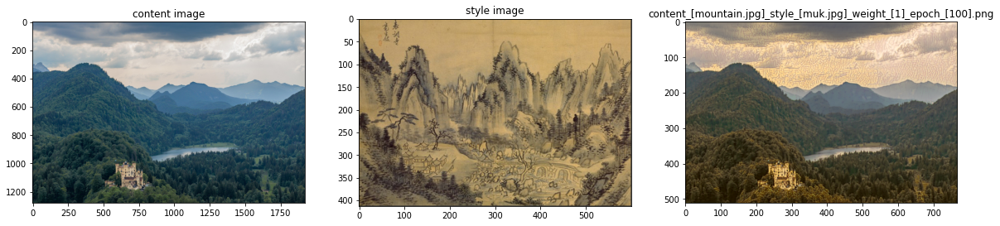

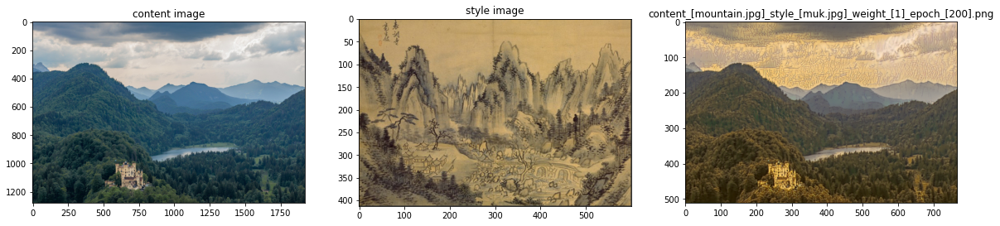

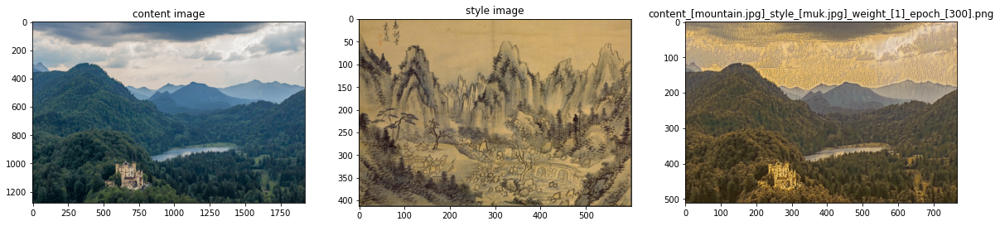

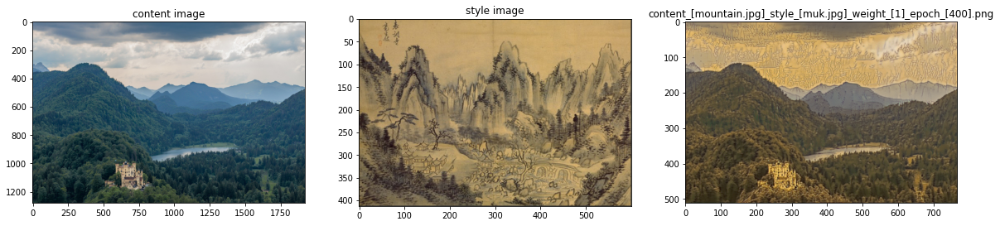

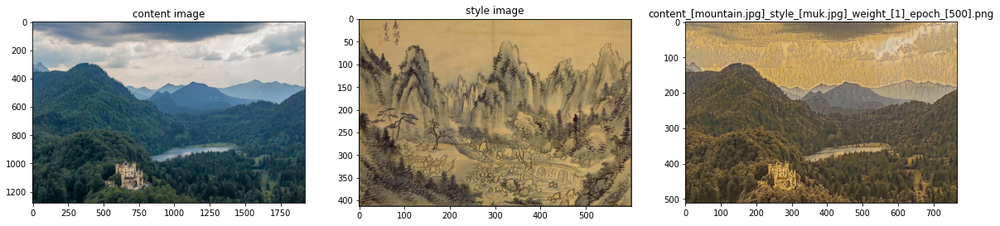

...

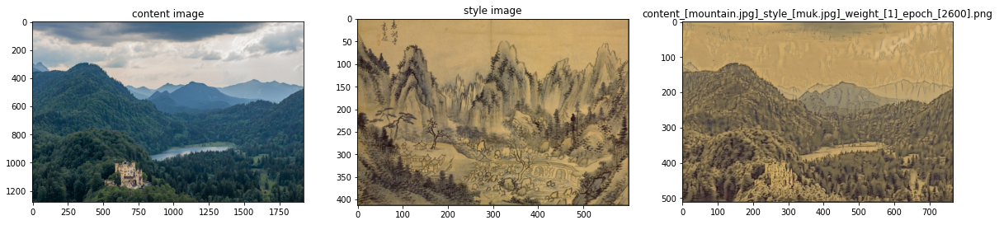

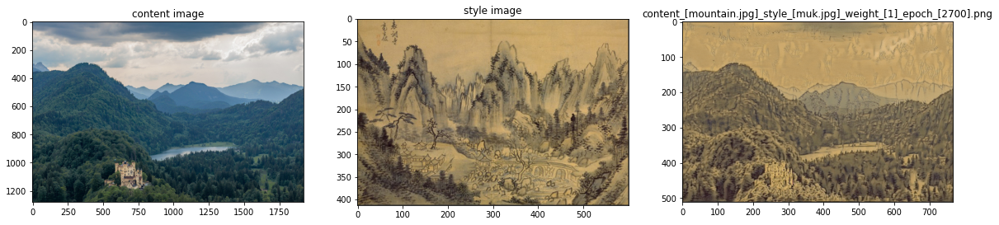

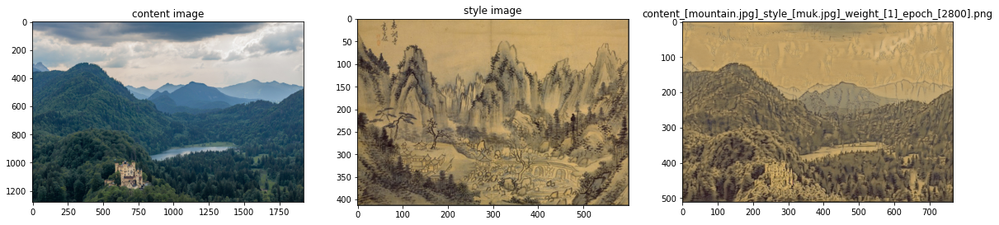

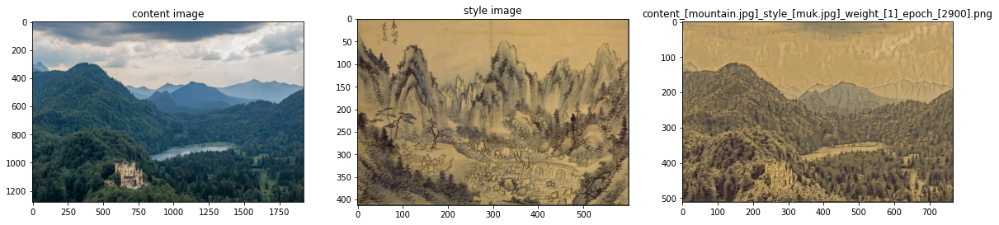

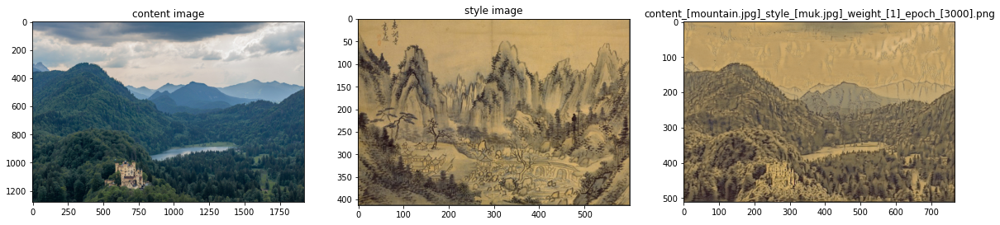

In [16]:
content_img = Image.open(os.path.join(config.content_img))
style_img = Image.open(os.path.join(config.style_img))

name = 'content_[{}]_style_[{}]'.format(config.content_img.split('/')[-1], config.style_img.split('/')[-1])
for image_path in os.listdir(config.save_path):
    if image_path.startswith(name):
        target_img = Image.open(os.path.join(config.save_path, image_path))
        draw_images(content_img, style_img, target_img, image_path)